In [1]:
import h5py
from PIL import Image

In [3]:
hdf5_path = "/home/yygx/Dropbox/Codes/UNC_Research/pkgs_simu/LIBERO/libero/datasets/bl3/tmp/modified/KITCHEN_SCENE10_close_the_top_drawer_of_the_cabinet_0_demo.hdf5"
# hdf5_path = "/home/yygx/Dropbox/Codes/UNC_Research/pkgs_simu/LIBERO/libero/datasets/bl3/tmp/modified/KITCHEN_SCENE2_put_the_black_bowl_at_the_back_on_the_plate_0_demo.hdf5"
hdf5_path = "/home/yygx/Dropbox/Codes/UNC_Research/pkgs_simu/LIBERO/libero/datasets/bl3/tmp/modified/KITCHEN_SCENE1_open_the_bottom_drawer_of_the_cabinet_0_demo.hdf5"
f = h5py.File(hdf5_path, "r")
len(list(f["data"].keys()))

50

In [2]:
import os
folder_pth = "/home/yygx/Dropbox/Codes/UNC_Research/pkgs_simu/LIBERO/libero/datasets/bl3/tmp/modified"
files = sorted(os.listdir(folder_pth))
for file in files:
    if file == "KITCHEN_SCENE2_put_the_black_bowl_at_the_back_on_the_plate_0_demo.hdf5":
        continue
    file_pth = os.path.join(folder_pth, file)
    f = h5py.File(file_pth, "r")
    print(file)
    print(len(list(f["data"].keys())))


KITCHEN_SCENE10_close_the_top_drawer_of_the_cabinet_0_demo.hdf5
50


OSError: Unable to synchronously open file (file signature not found)

In [24]:
def hdf5_to_dict(group):
    result = {}
    for key, item in group.items():
        if isinstance(item, h5py.Group):  # If the item is a group, recursively convert it
            result[key] = hdf5_to_dict(item)
        elif isinstance(item, h5py.Dataset):  # If the item is a dataset, convert it to a numpy array
            result[key] = item[()]
        else:
            raise TypeError(f"Unsupported HDF5 item type: {type(item)}")
    return result

def load_hdf5_file_to_dict(file_path):
    with h5py.File(file_path, 'r') as f:
        return hdf5_to_dict(f)

In [25]:
data = load_hdf5_file_to_dict(hdf5_path)
data['data'].keys()

dict_keys(['demo_1'])

In [27]:
data['data']['demo_1']['obs']['agentview_rgb'][0].shape

(512, 512, 3)

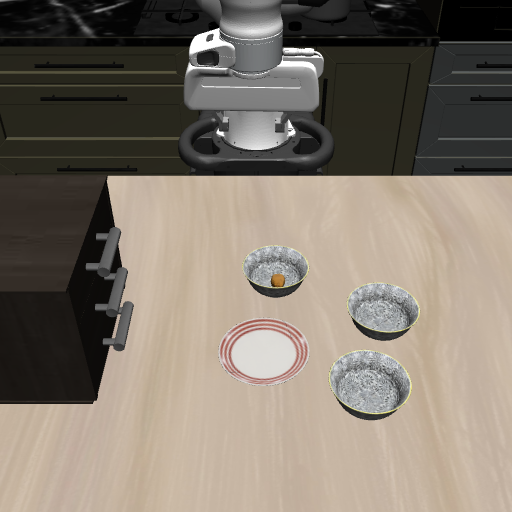

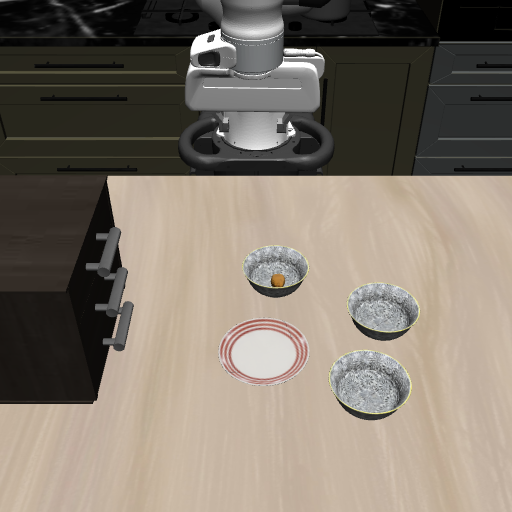

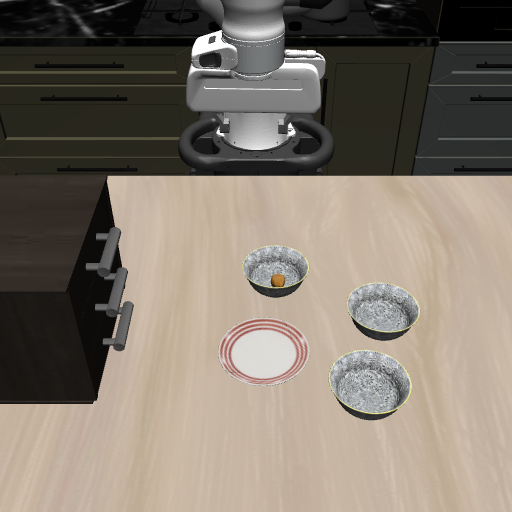

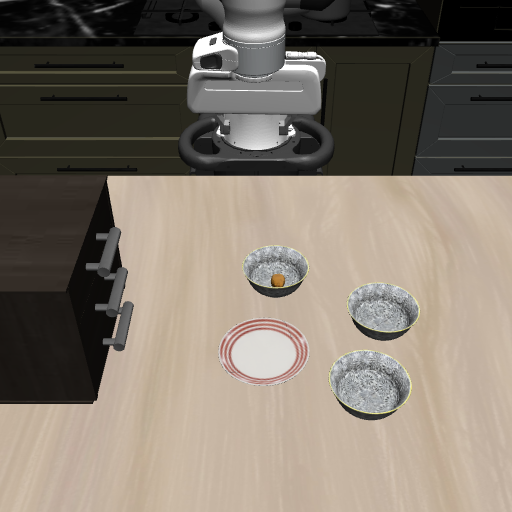

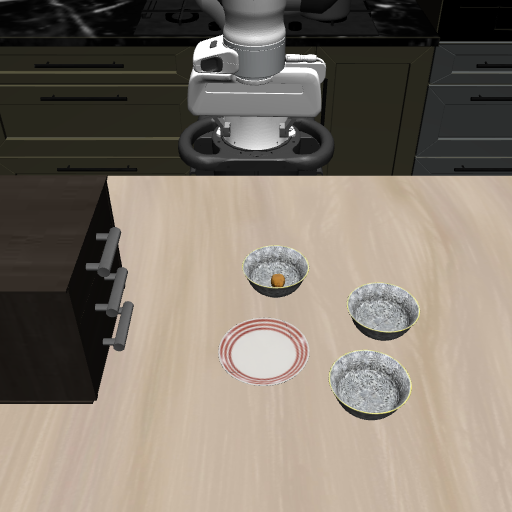

...

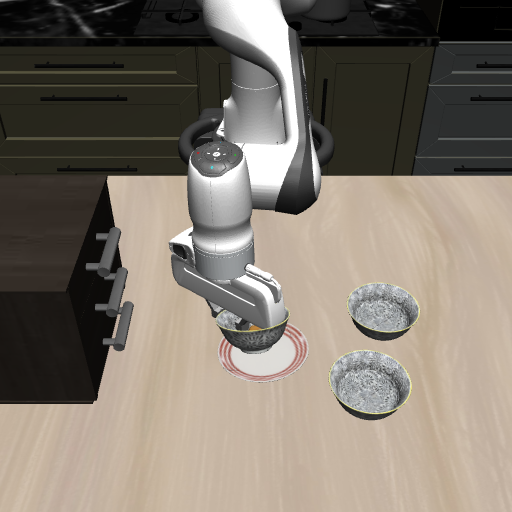

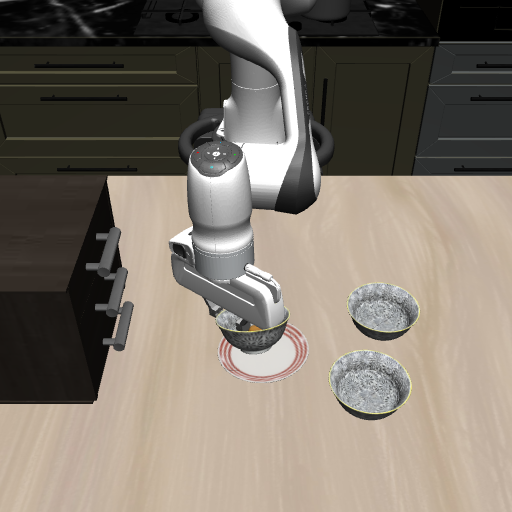

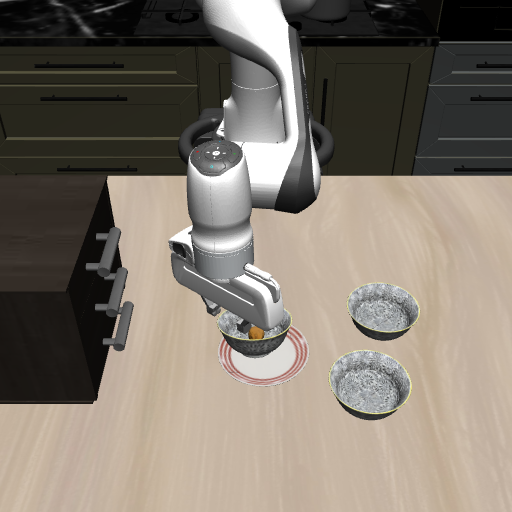

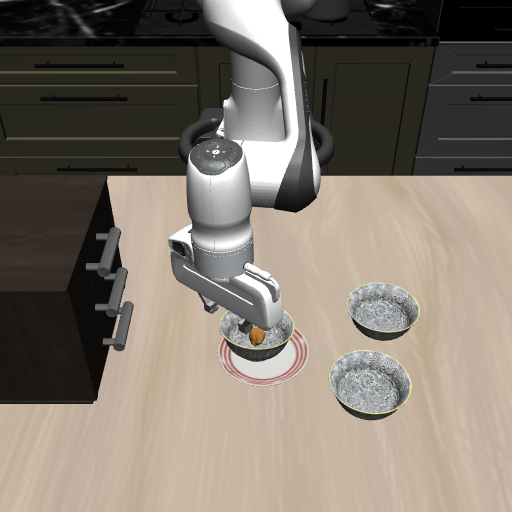

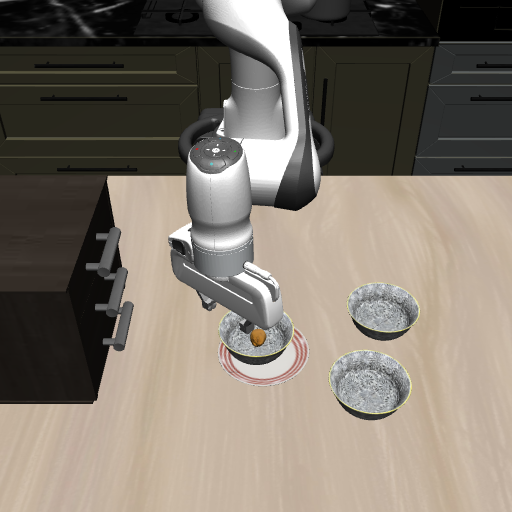

IndexError: index 95 is out of bounds for axis 0 with size 95

In [28]:
for i in range(100):
    display(Image.fromarray(data['data']['demo_1']['obs']['agentview_rgb'][i][::-1]))